In [1]:
#Importing necessary libraries
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab import files


In [4]:
# Upload image
uploaded = files.upload()
image_file = list(uploaded.keys())[0]

# Read the uploaded image
img = cv2.imread(image_file, 0)

np_img = np.array(img)

# Print type and shape
print(type(np_img))
print(np_img.shape)

def plot_image(image, title='Image', show_axis=False):
    plt.figure(figsize=(8, 8))
    plt.imshow(image, cmap='gray')
    plt.title(title)
    if not show_axis:
        plt.axis('off')
    plt.show()

Saving bright.tif to bright.tif
<class 'numpy.ndarray'>
(500, 500)


Enter a threshold value: 180


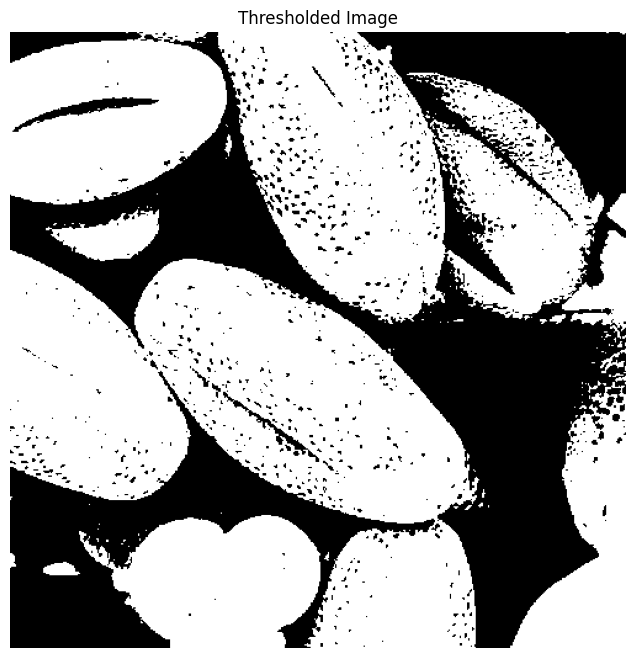

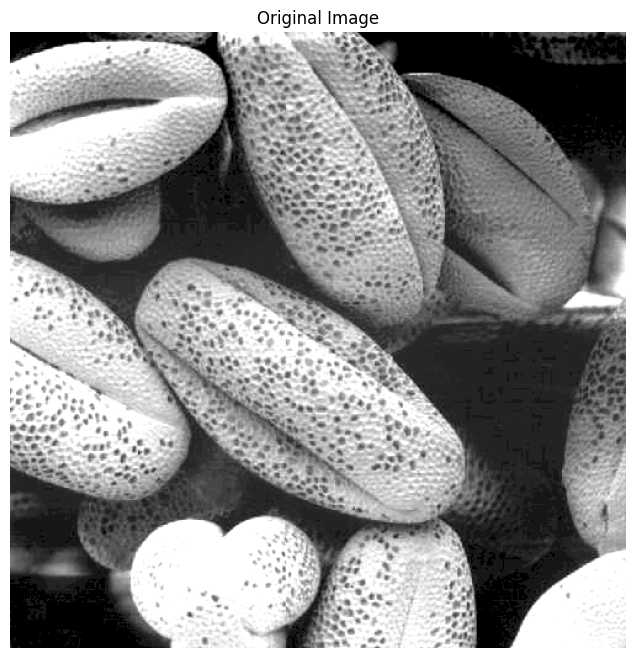

In [5]:
def imageThresholding(T):
    thresholded_image = np.zeros_like(np_img)  # Create an array with zeros for the output
    for i in range(np_img.shape[0]):
        for j in range(np_img.shape[1]):
            if np_img[i][j] > T:
                thresholded_image[i][j] = 255
            else:
                thresholded_image[i][j] = 0
    return thresholded_image

threshold = int(input('Enter a threshold value: '))
threshold_image = imageThresholding(threshold)

plot_image(threshold_image, title='Thresholded Image')
plot_image(img, title='Original Image')









**2. Image arithmetic operations**

In [6]:
img1 = cv2.imread('/content/bright.tif',0)
np_img1 = np.array(img1)


print(type(np_img1))

#  shape
print(np_img1.shape)


img2 = cv2.imread('/content/dark.tif',0)
np_img2 = np.array(img2)

print(type(np_img2))

#  shape
print(np_img2.shape)

<class 'numpy.ndarray'>
(500, 500)
<class 'numpy.ndarray'>
(500, 500)


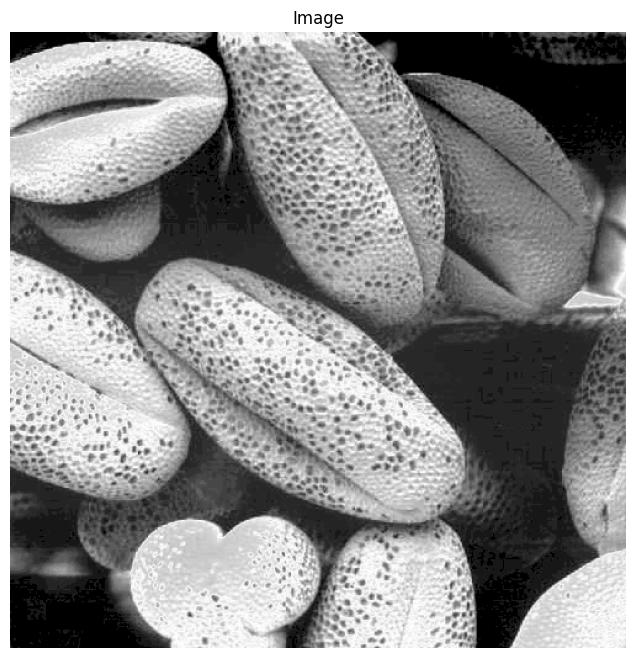

In [13]:

# def addition(I1,I2, size):
#     new_height, new_width = size
#     height, width = I1.shape
#     added_image = np.zeros((new_height, new_width), dtype=I1.dtype)

#     for i in range(new_height):
#         for j in range(new_width):
#             x= I1[i, j]
#             y = I2[i, j]
#             added_image[i, j] = x + y

#     return added_image
# add_image=addition(np_img1,np_img2,(500,500))
# plot_image(add_image)


def sub(I1,I2):
  res_sub=np_img1-np_img2
  return res_sub

res_sub=sub(np_img1,np_img2)
plot_image(res_sub)

#with opencv
sub_img_with_cv= cv2.subtract(img1, img2)
plot_image(sub_img_with_cv)

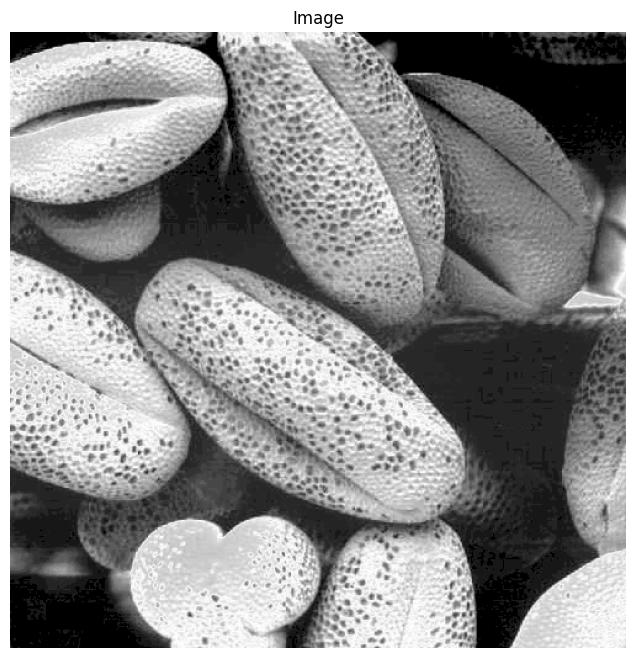

In [14]:

# def sub(I1,I2, size):
#     new_height, new_width = size
#     height, width = I1.shape
#     sub_image = np.zeros((new_height, new_width), dtype=I1.dtype)

#     for i in range(new_height):
#         for j in range(new_width):
#             x= I1[i, j]
#             y = I2[i, j]
#             sub_image[i, j] = x - y

#     return sub_image

# sub_image=sub(np_img1,np_img2,(500,500))
# plot_image(sub_image)


# def add(I1,I2):
#   res_add=np_img1+np_img2
#   return res_add
# res_add=add(np_img1,np_img2)
# plot_image(res_add)

#with opencv
sub_img_with_cv= cv2.subtract(img1, img2)
plot_image(sub_img_with_cv)

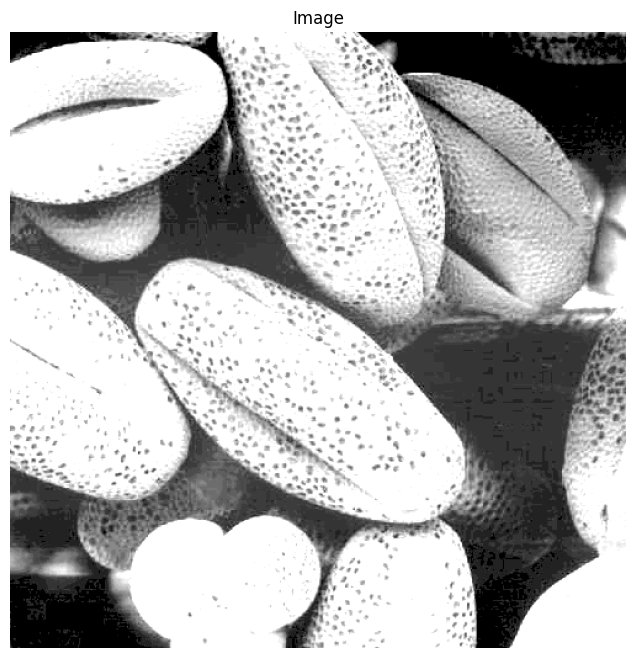

In [ ]:
#with opencv
add_img_with_cv= cv2.add(img1, img2)
plot_image(add_img_with_cv)

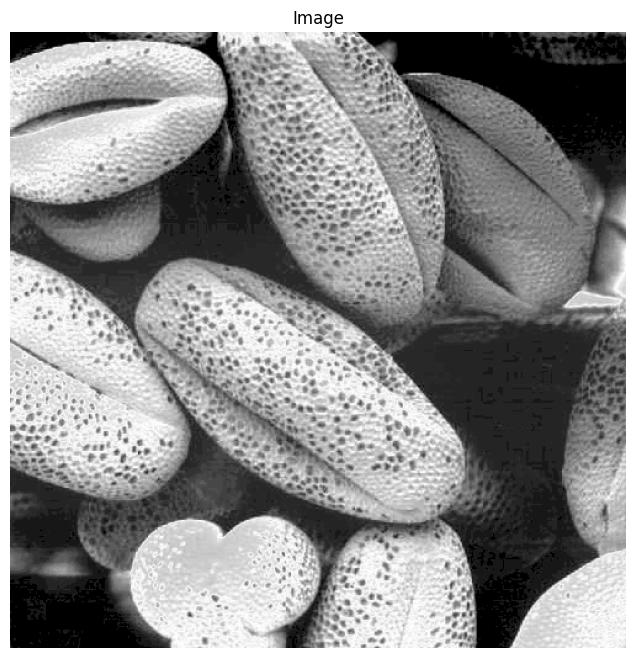

**a. Log transformation**

<ipython-input-15-dd999bb596ae>:5: RuntimeWarning: divide by zero encountered in log
  log_image = c * (np.log(image + 1))
<ipython-input-15-dd999bb596ae>:9: RuntimeWarning: invalid value encountered in cast
  log_image = np.array(log_image, dtype = np.uint8)


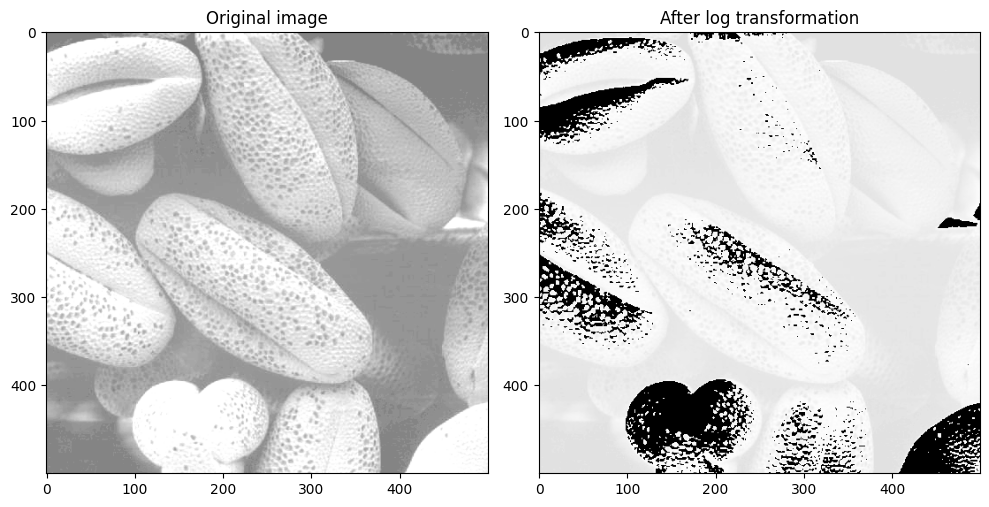

In [15]:

image = cv2.imread('/content/bright.tif')

# Apply log transformation method
c = 255 / np.log(1 + np.max(image))
log_image = c * (np.log(image + 1))

# Specify the data type so that
# float value will be converted to int
log_image = np.array(log_image, dtype = np.uint8)

# Display both images
plt.figure(figsize=(10, 10))
# Original image
plt.subplot(1, 2, 1)  # 1 rows, 2 columns, 1st subplot
plt.imshow(image)
plt.title('Original image')
plt.subplot(1, 2, 2) #2nd subplot
plt.imshow(log_image)
plt.title('After log transformation')

# Show the figure with all images
plt.tight_layout()
plt.show()

gamma_correct = 255*(I/255)**gamma

**b. Power transformation**

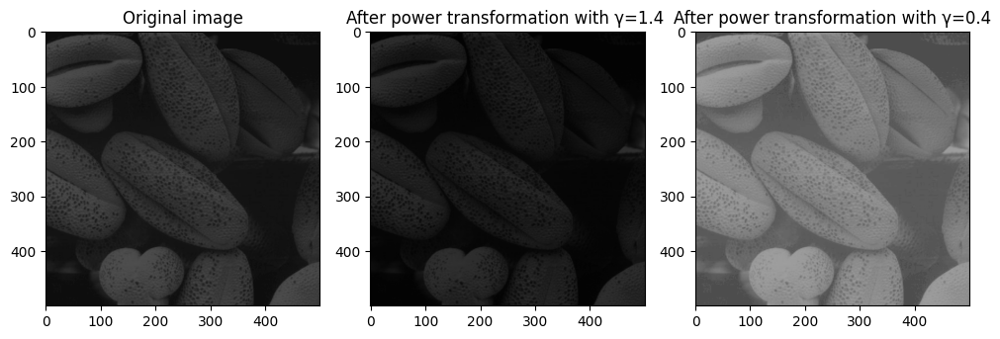

In [131]:
# Read an image
image_gamma = cv2.imread('/content/dark.tif')

#Gamma Correction with γ=1.4
gamma_one_point_four = np.array(255*(image_gamma/255)**1.4,dtype='uint8')

#Gamma Correction with γ=0.4
gamma_point_four = np.array(255*(image_gamma/255)**0.4,dtype='uint8')

# Display the images in subplots
plt.figure(figsize=(10, 10))
# Original image
plt.subplot(1, 3, 1)  # 1 rows, 2 columns, 1st subplot
plt.imshow(image_gamma)
plt.title('Original image')

plt.subplot(1, 3, 2)
plt.imshow(gamma_one_point_four, cmap='gray')
plt.title('After power transformation with γ=1.4 ')
plt.subplot(1, 3, 3)
plt.imshow(gamma_point_four, cmap='gray')
plt.title('After power transformation with γ=0.4')
# Show the figure with all images
plt.tight_layout()
plt.show()

**c. Contrast Stretching**

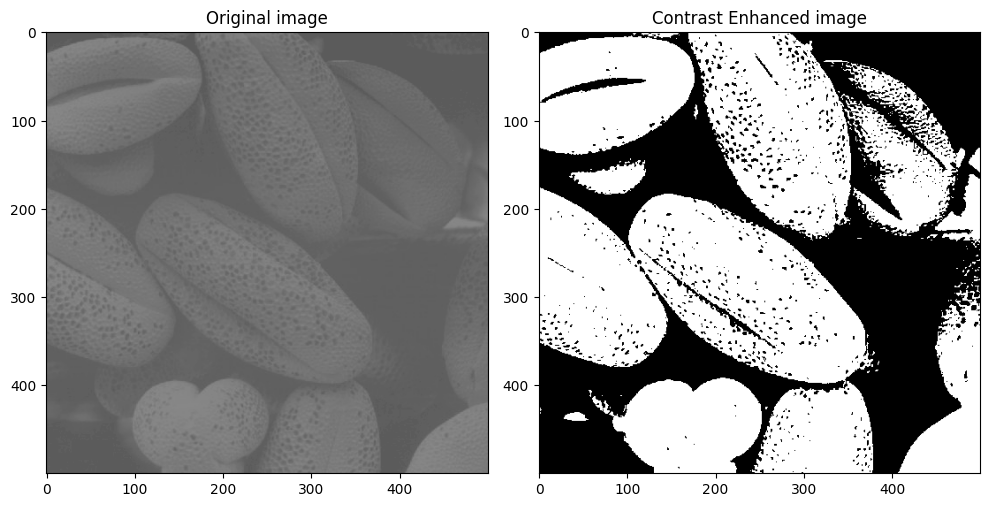

In [53]:
# Read an image
image = cv2.imread('/content/low_contrast.tif')
# Define the contrast stretching function
def pixelVal(pix, r1, s1, r2, s2):
    if (0 <= pix and pix <= r1):
        return (s1 / r1)*pix
    elif (r1 < pix and pix <= r2):
        return ((s2 - s1)/(r2 - r1)) * (pix - r1) + s1
    else:
        return ((255 - s2)/(255 - r2)) * (pix - r2) + s2
r1 = 105
s1 = 0
r2 = 210
s2 = 255
pixelVal_vec = np.vectorize(pixelVal)

# Apply contrast stretching.
contrast_stretched = pixelVal_vec(image, r1, s1, r2, s2)

# Display both images
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)  # 1 rows, 2 columns, 1st subplot
plt.imshow(image)
plt.title('Original image')

plt.subplot(1, 2, 2)
plt.imshow(contrast_stretched)
plt.title('Contrast Enhanced image')

# Show the figure with all images
plt.tight_layout()
plt.show()

**d. Gray level slicing**

Gray Level Slicing without Background Preservation

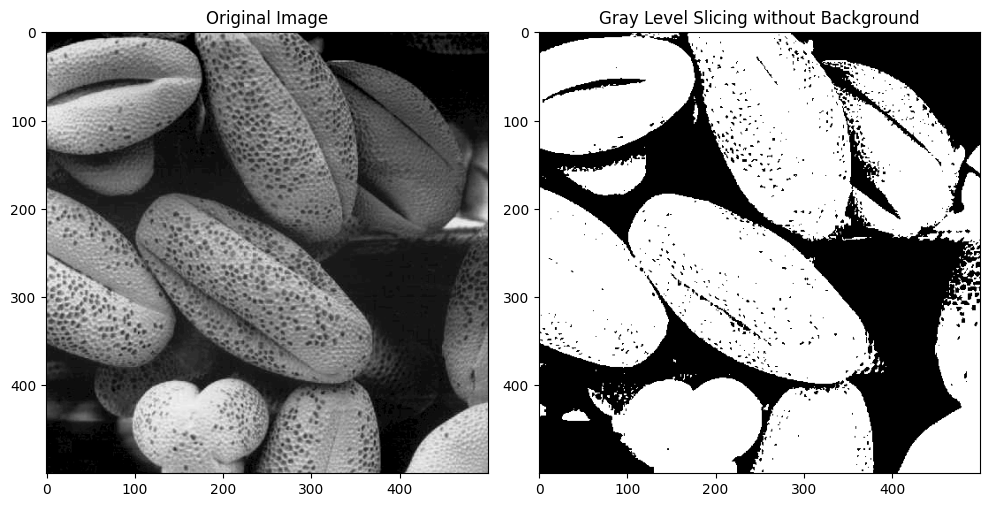

In [62]:
# Read an image
dark_image = cv2.imread('/content/dark.tif',cv2.IMREAD_GRAYSCALE)
# Define the range for gray level slicing
lower_bound = 30
upper_bound = 120

# Create an empty array with the same shape as the image
sliced_image_without_bg = np.zeros_like(dark_image)

# Set the pixels within the specified range to the maximum intensity (255)
sliced_image_without_bg[(dark_image >= lower_bound) & (dark_image <= upper_bound)] = 255

# Display the original and sliced images
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.imshow(dark_image, cmap='gray')
plt.title('Original Image')
plt.subplot(1, 2, 2)
plt.imshow(sliced_image_without_bg, cmap='gray')
plt.title('Gray Level Slicing without Background')
plt.tight_layout()
plt.show()






Gray Level Slicing with Background Preservation

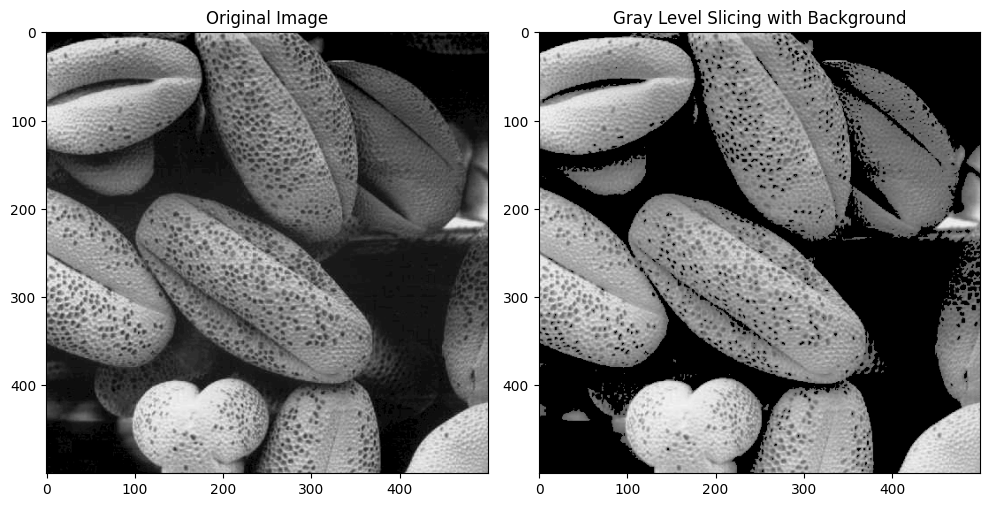

In [63]:
# Create a copy of the original image for background preservation
sliced_image_with_bg = dark_image.copy()

# Set the pixels outside the specified range to 0 (black) to highlight the range of interest
sliced_image_with_bg[(dark_image < lower_bound) | (dark_image > upper_bound)] = 0

# Display the original and sliced images
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(dark_image, cmap='gray')
plt.title('Original Image')

plt.subplot(1, 2, 2)
plt.imshow(sliced_image_with_bg, cmap='gray')
plt.title('Gray Level Slicing with Background')

plt.tight_layout()
plt.show()


**e. Bit plane slicing**

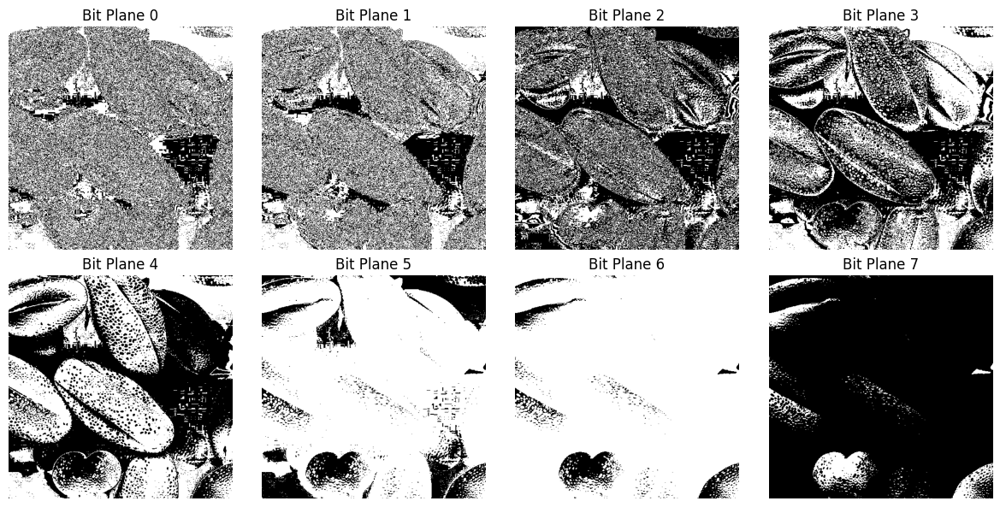

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Read the image in grayscale
image = cv2.imread('/content/low_contrast.tif', cv2.IMREAD_GRAYSCALE)

# Function to extract individual bit planes
def bit_plane_slicing(image):
    bit_planes = []
    # Loop through each bit plane (0 to 7)
    for i in range(8):
        # Extract the i-th bit plane using bitwise AND and right shift
        bit_plane = (image & (1 << i)) >> i
        # Scale it up to visualize it better
        bit_plane = bit_plane * 255
        bit_planes.append(bit_plane)

    return bit_planes

# Get the bit planes
bit_planes = bit_plane_slicing(image)

# Plot the bit planes
plt.figure(figsize=(12, 6))
for i in range(8):
    plt.subplot(2, 4, i + 1)
    plt.imshow(bit_planes[i], cmap='gray')
    plt.title(f'Bit Plane {i}')
    plt.axis('off')
plt.tight_layout()
plt.show()


**Lab task 3_2**

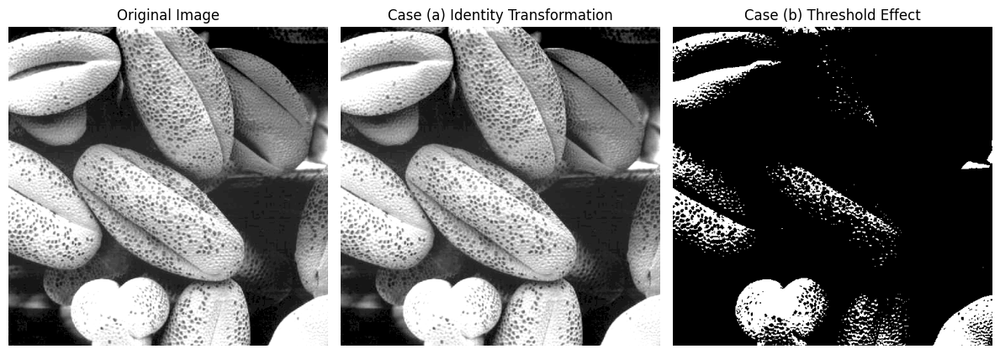

In [66]:


# Read the image in grayscale mode
image = cv2.imread('/content/bright.tif', cv2.IMREAD_GRAYSCALE)

# Define the contrast stretching function
def contrast_stretching(image, r1, s1, r2, s2):
    # Create a lookup table based on the pixel transformation equation
    def pixelVal(pix, r1, s1, r2, s2):
        if 0 <= pix <= r1:
            return (s1 / r1) * pix
        elif r1 < pix <= r2:
            return ((s2 - s1) / (r2 - r1)) * (pix - r1) + s1
        else:
            return ((255 - s2) / (255 - r2)) * (pix - r2) + s2

    # Ensure all the parameters are passed to the vectorized function
    pixelVal_vec = np.vectorize(lambda pix: pixelVal(pix, r1, s1, r2, s2))

    # Apply contrast stretching using the vectorized function
    stretched_image = pixelVal_vec(image).astype(np.uint8)
    return stretched_image

# Case (a): r1 = s1, r2 = s2 (Identity transformation)
r1_a, s1_a = 50, 50
r2_a, s2_a = 200, 200
identity_image = contrast_stretching(image, r1_a, s1_a, r2_a, s2_a)

# Case (b): r1 = r2, s1 = 0, s2 = L-1 (Threshold effect)
L = 255
r1_b, r2_b = 128, 128
s1_b, s2_b = 0, L - 1
threshold_image = contrast_stretching(image, r1_b, s1_b, r2_b, s2_b)

# Plot the original and transformed images
plt.figure(figsize=(12, 6))
plt.subplot(1, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(identity_image, cmap='gray')
plt.title('Case (a) Identity Transformation')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(threshold_image, cmap='gray')
plt.title('Case (b) Threshold Effect')
plt.axis('off')

plt.tight_layout()
plt.show()


# **Masking**

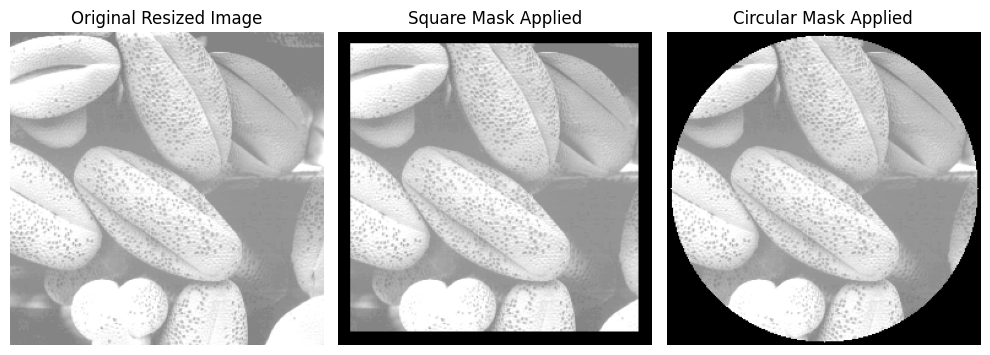

In [79]:

image = cv2.imread('/content/bright.tif')
# Resize the image to 256x256
resized_image = cv2.resize(image, (256, 256))

# Create square and circular masks
mask_square = np.zeros((256, 256), dtype=np.uint8)
mask_circle = np.zeros((256, 256), dtype=np.uint8)

# Draw the square mask
cv2.rectangle(mask_square, (10, 10), (244, 244), 255, -1)

# Draw the circular mask
cv2.circle(mask_circle, (128, 128), 125, 255, -1)

# Apply the masks to the image
image_square_masked = cv2.bitwise_and(resized_image, resized_image, mask=mask_square)
image_circle_masked = cv2.bitwise_and(resized_image, resized_image, mask=mask_circle)

# Display the results
plt.figure(figsize=(10, 5))

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
plt.title('Original Resized Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(cv2.cvtColor(image_square_masked, cv2.COLOR_BGR2RGB))
plt.title('Square Mask Applied')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(image_circle_masked, cv2.COLOR_BGR2RGB))
plt.title('Circular Mask Applied')
plt.axis('off')

plt.tight_layout()
plt.show()


# **Brightness**

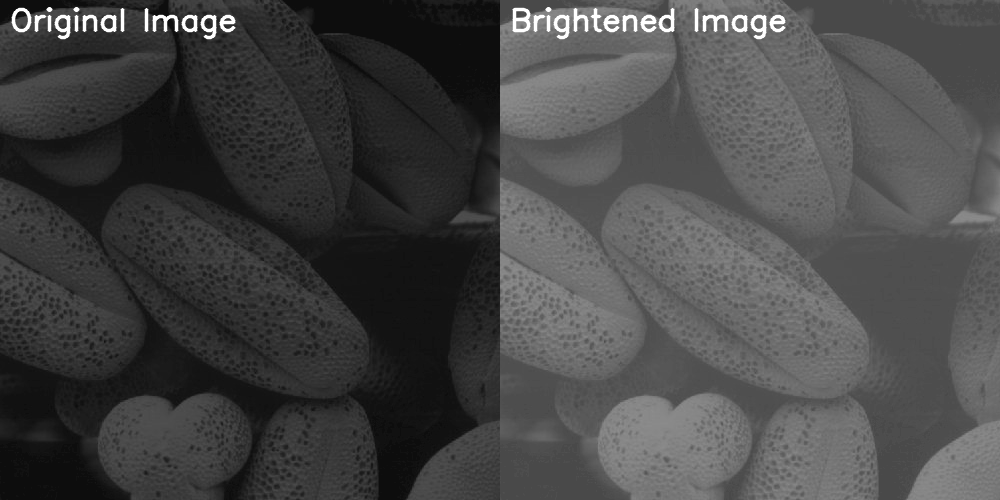

In [101]:

from google.colab.patches import cv2_imshow

def addbrightness(image, value):
    # Ensure the beta value is an integer
    value = int(value)
    # Create a new image by adding the beta value to each pixel
    brightened_image = cv2.add(image, np.array([value, value, value], dtype=np.uint8))

    return brightened_image

# Load an image from file
image_path = '/content/dark.tif'
image = cv2.imread(image_path)

brightness_value = 60
brightened_image = addbrightness(image, brightness_value)

# Create a new blank image to hold the concatenated images
height = max(image.shape[0], brightened_image.shape[0])
width = image.shape[1] + brightened_image.shape[1]
combined_image = np.zeros((height, width, 3), dtype=np.uint8)

 # Place the original image and the brightened image into the combined image
combined_image[:image.shape[0], :image.shape[1]] = image
combined_image[:brightened_image.shape[0], image.shape[1]:] = brightened_image

# Add titles to the images
cv2.putText(combined_image, 'Original Image', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)
cv2.putText(combined_image, 'Brightened Image', (image.shape[1] + 10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2, cv2.LINE_AA)

# Display the combined image
cv2_imshow(combined_image)


# **Histogram**

**Histogram Calculation in OpenCV**

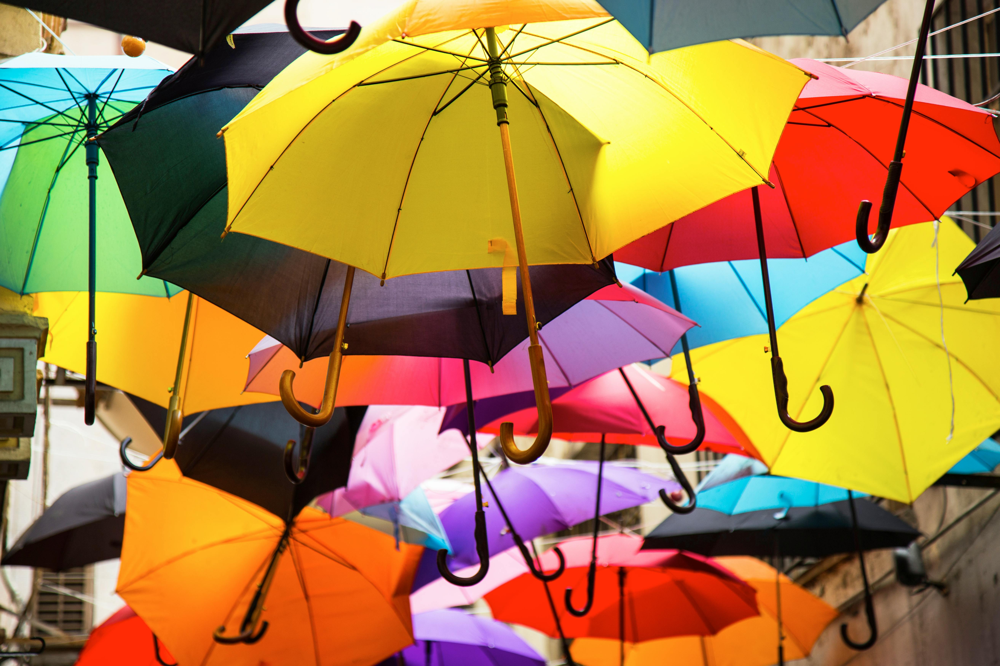

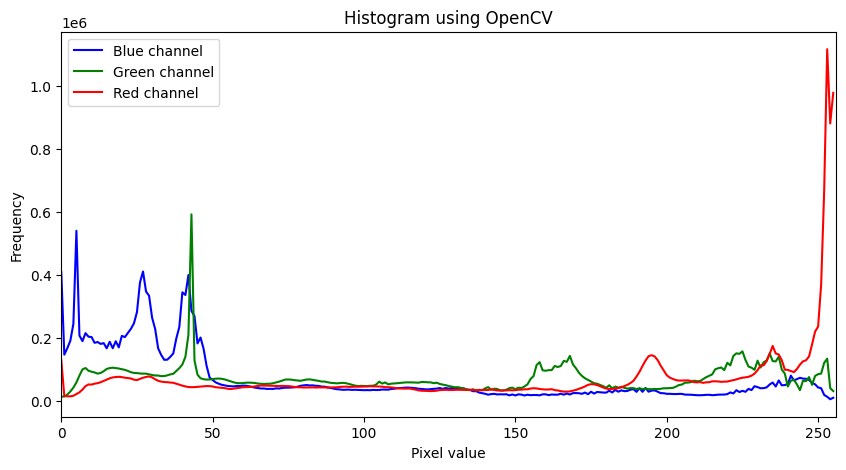

In [134]:

image_path = '/content/pexels-enginakyurt-1451040.jpg'
image = cv2.imread(image_path)
cv2_imshow(image)

# Histogram Calculation using OpenCV
def show_histogram_opencv(image):
    hist_b = cv2.calcHist([image], [0], None, [256], [0, 256])  # Blue
    hist_g = cv2.calcHist([image], [1], None, [256], [0, 256])  # Green
    hist_r = cv2.calcHist([image], [2], None, [256], [0, 256])  # Red

    plt.figure(figsize=(10, 5))
    plt.title('Histogram using OpenCV')
    plt.xlabel('Pixel value')
    plt.ylabel('Frequency')
    plt.xlim([0, 256])
    plt.plot(hist_b, color='blue', label='Blue channel')
    plt.plot(hist_g, color='green', label='Green channel')
    plt.plot(hist_r, color='red', label='Red channel')
    plt.legend()
    plt.show()

show_histogram_opencv(image)


**Histogram Calculation in NumPy**

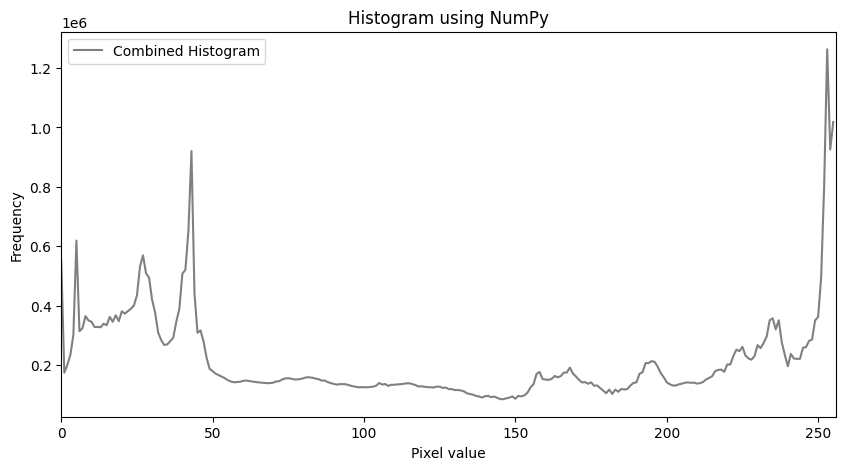

In [135]:
def show_histogram_numpy(image):
    hist_np, bins_np = np.histogram(image.flatten(), bins=256, range=[0, 256])

    plt.figure(figsize=(10, 5))
    plt.title('Histogram using NumPy')
    plt.xlabel('Pixel value')
    plt.ylabel('Frequency')
    plt.xlim([0, 256])
    plt.plot(hist_np, color='gray', label='Combined Histogram')
    plt.legend()
    plt.show()
show_histogram_numpy(image)

**Custom Histogram Functions**

a. Histogram for a Grayscale Image

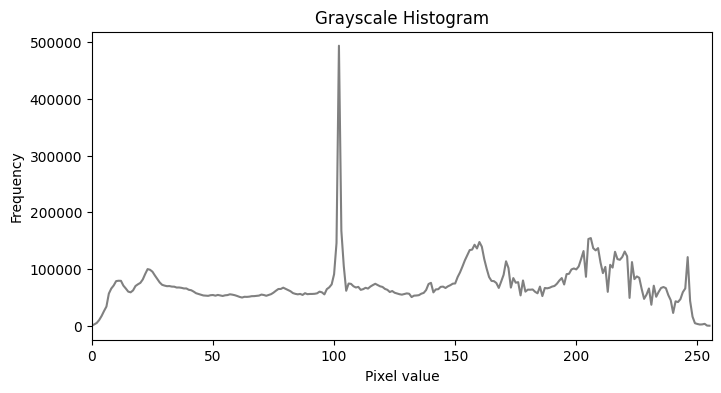

In [136]:
def show_grayscale_histogram(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)  # Convert to grayscale
    hist_gray = cv2.calcHist([gray_image], [0], None, [256], [0, 256])

    plt.figure(figsize=(8, 4))
    plt.title('Grayscale Histogram')
    plt.xlabel('Pixel value')
    plt.ylabel('Frequency')
    plt.xlim([0, 256])
    plt.plot(hist_gray, color='gray')
    plt.show()
show_grayscale_histogram(image)

b. Histograms for RGB Image

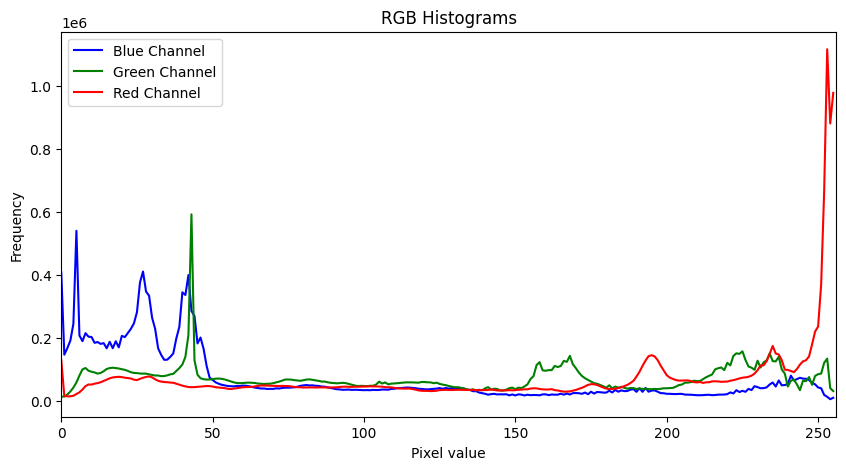

In [137]:
# Histograms for RGB Image
def show_rgb_histogram(image):
    # Split the image into R, G, B channels
    channels = cv2.split(image)
    colors = ('b', 'g', 'r')
    plt.figure(figsize=(10, 5))
    plt.title('RGB Histograms')
    plt.xlabel('Pixel value')
    plt.ylabel('Frequency')
    plt.xlim([0, 256])

    for channel, color in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)

    plt.legend(['Blue Channel', 'Green Channel', 'Red Channel'])
    plt.show()
show_rgb_histogram(image)

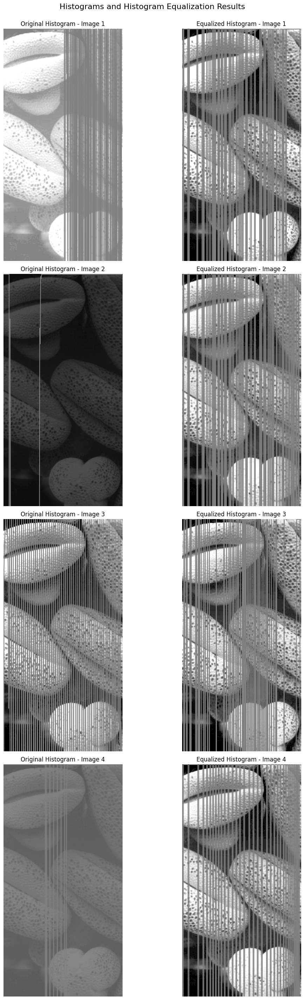

In [130]:

# Function to plot histograms
def plot_histogram(image, title, ax):
    hist = cv2.calcHist([image], [0], None, [256], [0, 256])
    ax.plot(hist, color='gray')
    ax.set_title(title)
    ax.set_xlabel('Pixel value')
    ax.set_ylabel('Frequency')
    ax.set_xlim([0, 256])

# Function to perform histogram equalization
def equalize_image(image):
    if len(image.shape) == 2:  # Grayscale image
        return cv2.equalizeHist(image)
    else:  # Color image
        # Convert to YUV color space for equalization
        yuv_image = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
        yuv_image[:, :, 0] = cv2.equalizeHist(yuv_image[:, :, 0])  # Equalize the Y channel
        return cv2.cvtColor(yuv_image, cv2.COLOR_YUV2BGR)

# Load images from the resources folder
image_paths = ['/content/bright.tif', '/content/dark.tif',
               '/content/high_contrast.tif', '/content/low_contrast.tif']

# Prepare the plot
fig, axs = plt.subplots(4, 2, figsize=(12, 30))
fig.suptitle('Histograms and Histogram Equalization Results', fontsize=16)

for i, image_path in enumerate(image_paths):
    # Load the image
    image = cv2.imread(image_path)

    # Check if the image has been loaded
    if image is None:
        print(f"Error: Could not load the image at {image_path}.")
        continue

    # Plot the original image histogram
    plot_histogram(image, f'Original Histogram - Image {i+1}', axs[i, 0])

    # Perform histogram equalization
    equalized_image = equalize_image(image)

    # Plot the equalized image histogram
    plot_histogram(equalized_image, f'Equalized Histogram - Image {i+1}', axs[i, 1])

    # Display the images
    axs[i, 0].axis('off')
    axs[i, 1].axis('off')
    axs[i, 0].imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    axs[i, 1].imshow(cv2.cvtColor(equalized_image, cv2.COLOR_BGR2RGB))

# Adjust layout
plt.tight_layout(rect=[0, 0.03, 1, 0.98])
plt.show()
